In [1]:
import torch.nn.functional as F
from torchvision import transforms 
from torch.utils.data import DataLoader
import numpy as np
import torch
from torch.optim import Adam
from torch import nn
from datasets import load_dataset
from torchvision.transforms import Compose, ToTensor, Lambda, ToPILImage, CenterCrop, Resize
import matplotlib.pyplot as plt
import math
from tqdm import tqdm
from torchvision.io import read_image

### Part 1. On attention [2 points]

Answer each question in max. 3 lines. Points will be subtracted for long answers so be short and precise. Add your explanations in the below box - NO added handwritten images, write in latex!

1. [0.5 point] You are given an input $X=[x_1,...,x_L]$ (e.g. a sentence of tokenised words). Your goal is to predict the next token $x_i$ conditional on $x_{1},...,x_{i}$. In other words, the $i$-th position can only be influenced by a position $j$ if and only if $j \leq i$, namely a position cannot be influenced by the subsequent positions.
    a. What would be the problem when passing $X$ through attention? Explain using the computations that attention performs, e.g. you can write out the matrix multiplication. 
    b. How could you ensure that the prediction for position $i$ depends solely on positions $j\leq i$? Hint: what in the attention computation should be masked & in what way? 
2. [0.5 point] Let's consider multi-head attention. How does multi-head attention change the computations inside the softmax (the $QK^T$ term) and the product with $V$ and why could this be beneficial to learning? 
3. [0.5 point] Remember that standard attention is given by 
\begin{align}
Q = XW^Q, \; K=XW^K, \; V=XW^V, \;\; \textnormal{with} A(X) = softmax\left(\frac{QK^T}{\sqrt{d_k}}\right)V
\end{align}
for a sequence $X\in\mathbb{R}^{L\times D}$ with $L$ the sequence length. 
What is the memory and computational cost of attention in terms of the sequence length and where does this come from? 
4. [0.5 point] A big focus these days is on making attention more computationally efficient. The $i$-th row (as a vector) of attention can be rewritten as, 
\begin{align}
A(X)_i = \frac{\sum_{j=1}^L sim(Q_i,K_j)V_j}{\sum_{j=1}^L sim(Q_i,K_j)},
\end{align}
with $sim(q,k)=exp(q^Tk/\sqrt{D})$.
Linear attention would be given by, 
\begin{align}
A(X)_i = \frac{\sum_{j=1}^L \phi(Q_i)^T\phi(K_j)V_j}{\sum_{j=1}^L\phi(Q_i)^T\phi(K_j)}. 
\end{align} 
Explain the relation between regular attentin and linear attention (i.e. what kind of similarity function does linear attention assume and how is the approximation made?) & how the above expression can be rewritten and use this to explain why linear attention computation can be done more efficiently compared to standard attention. 

Fill in your answers below. 

1. The problem with passing X through attention is that in the computation, from each $x_i$ comes a query, key, and value vector. In matrix form, $Q = XW^{Q}, V = XW^V, K = XW^K$. Then, in the computation, each query vector undergoes the dot product with every key vector. IE we have $q^{(i)} \cdot k^{(j)} \forall i, j$, ie $QK^T$ in matrix form. This is then passed through a softmax, scaled by the dimension and then matrix-multiplied by $V$. The issue is that for a given $i$, the response is influenced by $j > i$ through the dot product mentioned earlier, which is something we should not have (in the decoder). To ensure this doesn't happen, we can include a masking matrix $
M = \left[
\begin{array}{ccccc}
0 & -\infty & \cdots & -\infty & -\infty \\
0 & 0 & \cdots & -\infty & -\infty \\
\vdots & \vdots & \ddots & \vdots & \vdots \\
0 & 0 & \cdots & 0 & -\infty \\
0 & 0 & \cdots & 0 & 0
\end{array}
\right]$, and then include this in the softmax $A(X) = \text{softmax}\left(M + \frac{QK^T}{\sqrt{d_k}}\right)V$ to ensure that when exponentiated in the softmax, those terms with $j > i$ are 0.

2. Multi-head attention modifies attention by multiplying each of $K,Q, V$ by an additional weight matrix, specific to each attention head.So where before we had $\text{Attention}(Q,K,V) = A(X) = softmax\left(\frac{QK^T}{\sqrt{d_k}}\right)V$, now, we have $\text{head}_i = \text{Attention}(QW_i^Q, KW_i^K, VW_i^V)= \text{softmax}\left(\frac{QW_i^Q(KW_i^K)^T}{\sqrt{d_k}}\right)VW_i^V$. The output of each head is then concatenated: $\text{MultiHead}(Q, K, V) = \text{Concat}(\text{head}_1,\ldots,\text{head}_{n_h})W^O$. This is beneficial to learning because there could be multiple parts of the sequence that are relevant in the prediction of the next word. Hence in using multiple heads, the model can focus on multiple parts of the sequence at once, instead of averaging over the relevant parts with one head.

3. For a sequence length $L$, $X \in \mathbb{R}^{L \times D}, W^Q, W^K \in \mathbb{R}^{D \times d_k}$ (assuming $d_q = d_k$), and $W^V \in \mathbb{R}^{D \times d_v}$. Hence in computation of $Q,K,V$, the computational cost is in the order of $LDd_k$. Then in the softmax computation, $Q,K \in \mathbb{R}^{L \times d_k}$, hence $\frac{QK^T}{\sqrt{d_k}}$ has computational cost of order $L^2d_k$. Then calculating the softmax involves exponentiation of each term and then dividing by the corresponding row sum, this is of order $L^2$ (since it is an $L\times L$ matrix). Finally, the final matrix multiplication of the softmax matrix and $V$ results in an $L \times L$ matrix multiplied by a $L \times d_v$ matrix which has computational cost of order $L^2d_v$. Thus the computational complexity is of order $L^2$ assuming $d_k, d_v$ are relatively small compared to $L$. For memory costs, storing $X,Q,K,V$ scales linearly with $L$. Overall the memory cost is of order $L$, so it scales linearly.

4. Linear attention makes a slight change to regular attention. It assumes the similarity function can be represented as an inner product between feature map components: $\text{sim}(Q_i,K_j) \approx \phi(Q_i)\cdot \phi(K_j)$. We can rewrite the above expression as 
$A(X)_i = \frac{\phi(Q_i)^T\sum_{j=1}^L \phi(K_j)V_j^T}{\phi(Q_i)^T\sum_{j=1}^L\phi(K_j)}$ using matrix associativity. This form shows why and how linear attention can be done more efficiently than standard attention. This is because the summations on the numerator and denominator can be computed once and saved, and then reused for each value of $i$, compared to doing the computation each time. This saves computational power resulting in better efficiency.



### Part 2. On diffusion models [12 points]

We will be implementing a diffusion model. We will follow mostly the setup as done here: https://arxiv.org/pdf/2006.11239.pdf so please refer to this work for more details if needed. 

Your goal will be to implement the code for the diffusion model, find the right configuration to train the model, achieve good accuracy and efficiency and finally interpret how the model learns. You will be marked on clean code, concise answers and good results. 

We will be working with the FashionMNIST dataset. You can load the data using the below code. 

In [2]:
IMG_SIZE = 28
BATCH_SIZE = 128

# load dataset from the hub
dataset = load_dataset("fashion_mnist")
channels = 1

print("Done")

# define image transformations (e.g. using torchvision)
transform = Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(), # converts to [0,1],
            transforms.Lambda(lambda t: (t * 2) - 1)
])

# define function
def transforms(examples):
    examples["pixel_values"] = [transform(image.convert("L")) for image in examples["image"]]
    del examples["image"]
    return examples

transformed_dataset = dataset.with_transform(transforms).remove_columns("label")

dataloader = DataLoader(transformed_dataset['train'], batch_size=BATCH_SIZE, shuffle=True, drop_last=True)


Done


The following helper functions will be useful. In particular, whenever we input a vector (list) of values, this will help to select the right time t output. We will use this in the sampling loops. 

In [3]:
def get_index_from_list(vals, t, x_shape):
    """ 
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)


##### 1. The noising process [2 points]

[1.5 pts] Our first step will be to implement the forward process that adds noise to an image. 

We will be adding noise according to a linear schedule, i.e. the noises $\beta_t$, $t=1,...,T$ will come from an equally spaced vector. Implement the `linear_beta_schedule` function. Remember $\alpha_t = 1-\beta_t$ and $\bar \alpha_t = \prod_{s=1}^t \alpha_s$. 

Remember that we have the closed-form solutions for the image at time $t$. Use those in the implementation of `forward_diffusion_sample` instead of a for loop over each noising step. This means you will need to implement `sqrt_one_minus_alphas_cumprod` which represents $\sqrt{1-\bar\alpha_t}$ and `sqrt_alphas_cumprod` which represents $\sqrt{\bar\alpha_t}$. 

Test the function on an image from the dataset using the given code below. 

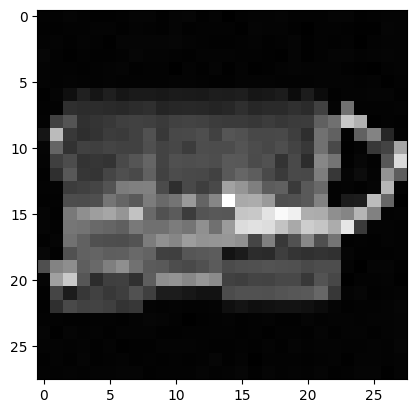

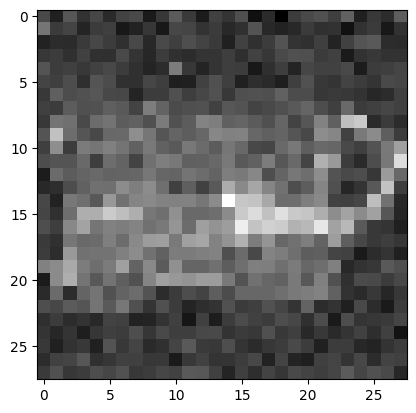

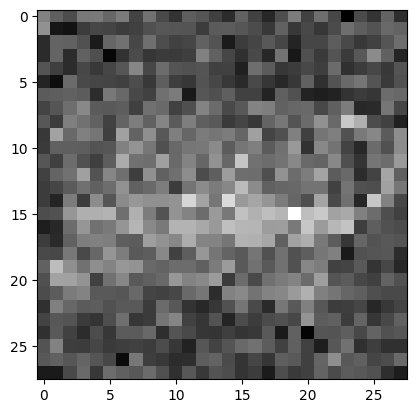

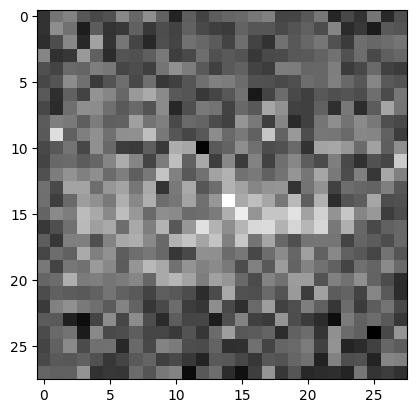

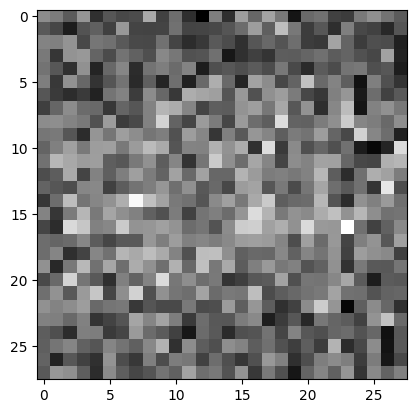

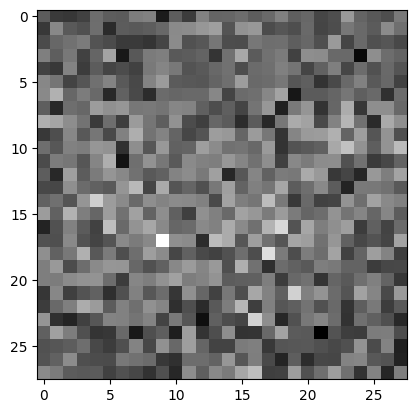

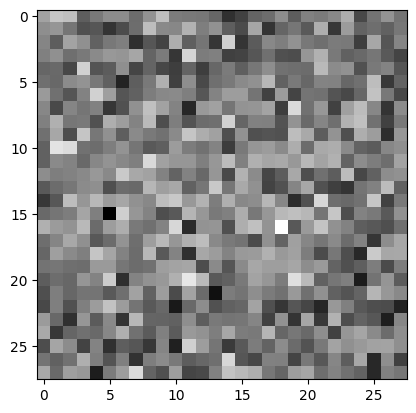

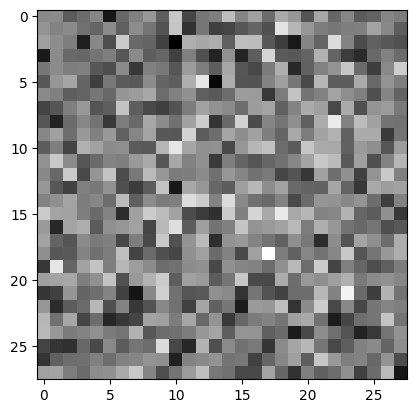

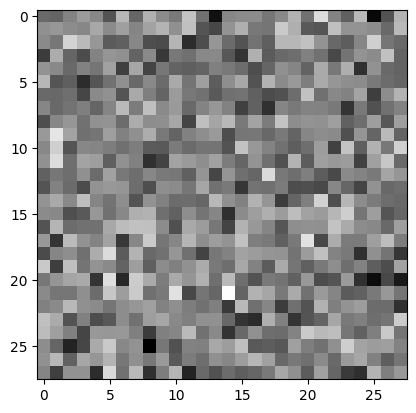

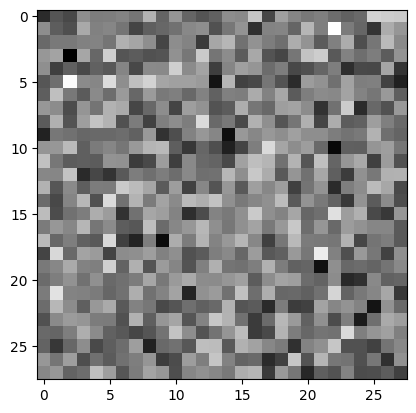

In [5]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    '''
    output a vector of size timesteps that is equally spaced between start and end; this will be the noise that is added in each time step. 
    '''
    return torch.linspace(start,end,steps = timesteps)

def forward_diffusion_sample(x_0, t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod, device="cpu"):
    """ 
    Takes an image and a timestep as input and 
    returns the noisy version of it
    Hint: use the get_index_from_list function to select the right values at time t. 
    """ 
    #noise:
    noise = torch.randn_like(x_0)
    # we have closed form solution due to markov process
    x = get_index_from_list(sqrt_alphas_cumprod,t,x_0.shape).to(device) * x_0.to(device) + get_index_from_list(sqrt_one_minus_alphas_cumprod,t,x_0.shape).to(device) * noise.to(device)
    return x, noise

# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
# ADD HERE THE COMPUTATIONS NEEDED for sqrt_alphas_cumprod and sqrt_one_minus_alphas_cumprod


def get_alphas(betas):
    alphas = 1 - betas
    cumprod_alphas = torch.cumprod(alphas,axis = 0)
    sqrt_alphas_cumprod = torch.sqrt(cumprod_alphas)
    sqrt_one_minus_alphas_cumprod = torch.sqrt(1 - cumprod_alphas)
    return sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod 


sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod = get_alphas(betas)

# Simulate forward diffusion
batch = next(iter(dataloader))["pixel_values"]
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    img,noise =  forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod)
    plt.imshow(img.reshape(IMG_SIZE, IMG_SIZE), cmap="gray")
    plt.show()

[0.5 pt] Play around with the noise (compare two different beta schedules), present results for the two settings and discuss (in max. 3 lines) how the hyperparameters change the forward sampling. 

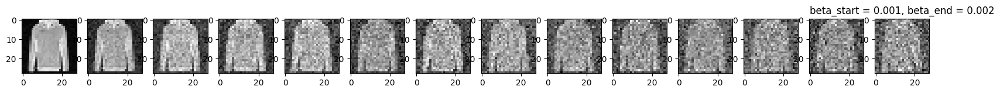

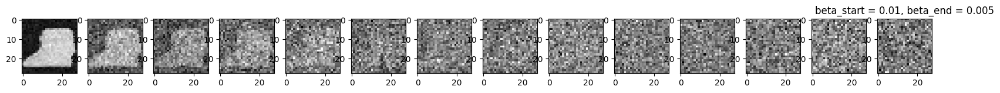

In [6]:
# Visualising noise:

betas_test1 = linear_beta_schedule(timesteps=T, start = 0.001, end =0.002)

sqrt_alphas_cumprod_test1, sqrt_one_minus_alphas_cumprod_test1 = get_alphas(betas_test1)

# Simulate forward diffusion, and show 14 states
#we choose 14 states so that it includes 299 too
batch = next(iter(dataloader))["pixel_values"]
num_images = 10
stepsize = 23

fig, axs = plt.subplots(nrows=1, ncols = 14)
fig.set_figwidth(20)
for i, idx in enumerate(range(0, T, stepsize)):
    t = torch.Tensor([idx]).type(torch.int64)
    img,noise =  forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod_test1, sqrt_one_minus_alphas_cumprod_test1)
    axs[i].imshow(img.reshape(IMG_SIZE, IMG_SIZE), cmap="gray")
plt.title("beta_start = 0.001, beta_end = 0.002")
plt.show()

#Now repeat for different schedule

betas_test2 = linear_beta_schedule(timesteps=T, start = 0.01, end = 0.05)

sqrt_alphas_cumprod_test2, sqrt_one_minus_alphas_cumprod_test2 = get_alphas(betas_test2)

# Simulate forward diffusion, and show 10 images
batch = next(iter(dataloader))["pixel_values"]
num_images = 10
stepsize = 23

fig, axs = plt.subplots(nrows=1, ncols = 14)
fig.set_figwidth(20)
for i, idx in enumerate(range(0, T, stepsize)):
    t = torch.Tensor([idx]).type(torch.int64)
    img,noise =  forward_diffusion_sample(batch[0,:,:,:], t, sqrt_alphas_cumprod_test2, sqrt_one_minus_alphas_cumprod_test2)
    axs[i].imshow(img.reshape(IMG_SIZE, IMG_SIZE), cmap="gray")
plt.title("beta_start = 0.01, beta_end = 0.005")
plt.show()



Since the images are equally spread over the beta range, the lower we set the start, the less distorted the starting image is, since less noise is added. The lower we set the end beta, the less distorted the final image is, this is seen in the first plot above. In the second plot, we increase the start and end values, and give a bigger range. This means the first image is more distorted than the other plot, and so is the final image. Also, the rate at which they distort is greater with the greater range, since the noise added at each iteration is larger due to stepping through the larger range in the same number of steps.

##### 2. The model for the noise [4 points]

We use a simple form of a UNet to predict the noise in the image. The input into the neural network will be a noisy image and the ouput from the model will be the noise in the image. It is important to also pass in the timestep into the neural network (so the model knows at which time we want to denoise the image) and we do this by passing it through a sinusoidal position embedding. 

[0.5pt] Write code for the Sinusoidal Position Embedding. This should output a matrix $PE$ of size `[timesteps, dimension]` with elements:

\begin{align}
&PE_{pos,2i} = \sin\left(\frac{pos}{10000^{2i/dim}}\right),\\
&PE_{pos,2i+1} = \cos\left(\frac{pos}{10000^{2i/dim}}\right),
\end{align}
where `pos` refers to the time position and `i` refers to the dimension position and `dim` the total dimension we are working with. 

Use however the following identity to implement: 
\begin{align}
\frac{pos}{10000^{2i/dim}} = \exp\left(\log(pos) - \frac{2i}{dim}\log(10000)\right).
\end{align}

In [7]:
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim
        #assuming even dimension
    def forward(self, pos):
        # Ensure pos is a torch.Tensor
        if not isinstance(pos, torch.Tensor):
            pos = torch.tensor(pos, dtype=torch.float32)
        #get device of time
        device = pos.device
        # Expand pos to [pos_size, 1] to perform broadcasting in next steps
        pos = torch.exp(torch.log(pos.unsqueeze(1)))
    
        # Compute the argument of the exponent using the given identity
        i = torch.arange(0, self.dim, dtype=torch.float32,device = device)
        div_term = torch.exp(torch.log(torch.tensor(10000.0)) * (-2 * i / self.dim)) 
        # Apply the identity for even and odd indices (sin and cos)
        embeddings = torch.zeros(pos.size(0), self.dim,device = device)
        embeddings[:, 0::2] = torch.sin(pos * div_term[0::2])
        embeddings[:, 1::2] = torch.cos(pos * div_term[1::2])

        return embeddings
    

[0.5pt] Visualise the positional embeddings with arbitary time and dimension and discuss what position embeddings do (why do we add them, why this particular embedding structure) in max. 3 lines. 

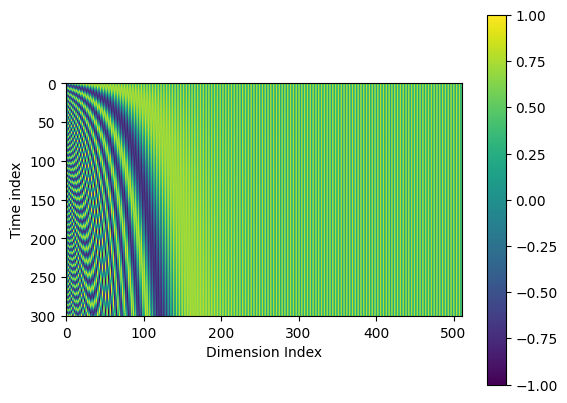

In [8]:
# Write here the code to visualise the positional embedding
spe = SinusoidalPositionEmbeddings(512)
time = torch.linspace(0,300,steps = 301,dtype = torch.int64)

a = spe(time)
plt.imshow(a)
plt.colorbar()
plt.xlabel("Dimension Index")
plt.ylabel("Time index")
plt.show()

We need the positional encodings since the relative positions of the pixels in the image are important. The Unet architecture is good at determining context spacially, however the positional encodings provide this information explicitly, which can improve performance. Positional encodings also have the added bonus of being able to generalise to image sizes or time steps that arent present in the training data (although care should be taken here). The reason that tihs particular embedding structure is chosen is that it satisfies the requirements of giving each position in time and space a unique encoding, and being deterministic. However they have the added bonus that differentiation is easy with them, they are infinite and periodic therefore scalable, and can capture relative positionings via offsets.

Below is the code for a Block, that will make up the final UNet. 

[0.5pt] Fill in the missing parts. 

Remember that in the UNet architecture, we have a downsampling phase and an upsampling phase. Depending on which phase we are in, we need to make use of the up or down-sample operations. 

[0.5pt] Add here an explanation as to what the block does including the up and downsample operations in maximum 3 lines:

The block does both upsampling and downsampling depending how it is called. It takes in a time embedding and an image tensor (or tensor from previous layer). If downsampling ,then it applies a convolutional layer that doubles the number of channels to the x tensor, if upsampling, it applies a convolutional layer that halves the number of channels (since if upsampling then concatenation with the residual is performed before). Both followed by batch normalisation and relu, before being combined with the output of a linear layer with relu with the time embedding passed through it. Then another convolutional layer is applied maintaining channels with batch normalisation and relu, before the up/downsampling stage is performed that either reduces or increases the x tensor dimensions (doubles or halves in this case if even dimension).

In [9]:
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        '''
        in_ch refers to the number of channels in the input to the operation and out_ch how many should be in the output
        '''
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        #self.bnorm1 = nn.GroupNorm(8,out_ch)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        #self.bnorm2 = nn.GroupNorm(8,out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)

        self.relu  = nn.ReLU()
    def forward(self, x, t):
        #time
        t = self.relu(self.time_mlp(t))
        #first convolution
        h = self.relu(self.bnorm1(self.conv1(x)))
        #add time, broadcasted accordingly
        h = h + t[...,None][...,None]
        #next conv
        h = self.relu(self.bnorm2(self.conv2(h)))        
        # upsample or downsample transform
        h = self.transform(h)
        return h


[1.5pt] Use the above code to fill in the code for the UNet below. 

In [10]:
class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        #original image channels
        image_channels = 1
        down_channels = (32,64,128) # These are the channels that we want to obtain in the downsampling stage
        up_channels = (128,64,32) # These are the channels that we want to obtain in the upsampling stage;
        #one output channel since one colour channel
        out_dim = 1
        #hyperparameter chosen, gives good results without needing to be too large
        time_emb_dim = 32
        #define Relu for later
        self.relu = nn.ReLU()
        # Time embedding consists of a Sinusoidal embedding, a linear map that maintains the dimensions and a rectified linear unit activation. 
        self.time_embedding = SinusoidalPositionEmbeddings(time_emb_dim)
        self.time_lin = nn.Linear(time_emb_dim,time_emb_dim)
        # Initial projection to the first dimension in the down channels
        self.initial_proj = nn.Conv2d(image_channels, down_channels[0],3,padding = 1)
        # Downsample, create a list
        self.down = nn.ModuleList([Block(down_channels[i], down_channels[i+1],time_emb_dim=time_emb_dim) for i in range(len(down_channels)-1)])
        # Upsample
        self.up= nn.ModuleList([Block(up_channels[i], up_channels[i+1],time_emb_dim=time_emb_dim, up = True) for i in range(len(up_channels)-1)])
        # Final output maps back to the output dimension from the last convolutional layer image channels
        self.finalconv = nn.Conv2d(up_channels[-1],out_dim,kernel_size=1)

        #self.bottleneck = nn.Conv2d(down_channels[-1], up_channels[0],3,padding = 1)
        
    def forward(self, x, timestep):
        #setup vector for residuals
        resid = []
        # Embedd time
        t = self.relu(self.time_lin(self.time_embedding(timestep)))
        h = x
        #initial projection
        h = self.initial_proj(h)
        #downsampling
        for block in self.down:
            h = block(h,t)
            #save the output residual for the skip connection
            resid.append(h)
        #h = self.bottleneck(h)

        #upsampling
        #reverse order of residuals since we use the most recent one first
        resid = resid[::-1]
        for i, block in enumerate(self.up):
            #concatenate the residuals with the main output
            h = torch.cat((h,resid[i]),dim = 1)
            h = block(h,t)

        #pass through final layer
        h = self.finalconv(h)
        return h

In [11]:
a = torch.rand([1,1,28,28])
t = torch.tensor([1])
model = SimpleUnet()
model(a,t).shape

torch.Size([1, 1, 28, 28])

[0.5pt] Finally, define a loss function. Note that this loss function should take x_0 and t to sample the forward diffusion model, get a noisy image, use this noisy image in the model to get the noise added and finally compare true added noise and model outputs added noise. 

In [12]:
def get_loss(model, x_0, t):
    #get the noisy image and the noise
    x_0_noise, noise = forward_diffusion_sample(x_0,t,sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod,"cuda")
    #get predicted noise from the model
    pred = model(x_0_noise,t)
    #from lectures, we opt for l2 loss between the noise and the prediction
    return F.mse_loss(noise, pred)

##### Part 3: The sampling [1 point]

Write a piece of code that can be used to predict the noise and return the denoised image. This function should work on a single image and make sure that the function can be used in the `sample` function properly. Note that we will need the `posterior_variance` denoted by $\sigma$ in the paper and the `sqrt_recip_alphas` given by $1/\alpha_t$. Make sure to set the right choice of $\sigma$ (see the paper). 

In [13]:
# compute posterior_variance 
#we get these from lectures
#we need the previous cumprod alpha for each time point, so we shift along and pad the first value with a 1 so it is unaffected

alphas_cumprod_prev = F.pad(torch.square(sqrt_alphas_cumprod)[:-1], (1, 0), value=1.0)
posterior_variance = betas * (1-alphas_cumprod_prev) / torch.square(sqrt_one_minus_alphas_cumprod)
sqrt_recip_alphas = 1/torch.sqrt(1 - betas) 

#following algorithm 2 in the notes, not updating the gradient
@torch.no_grad()
def sample_timestep(x, t, i, posterior_variance, sqrt_one_minus_alphas_cumprod,sqrt_recip_alphas):
    betas_t = get_index_from_list(betas,t,x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod,t,x.shape)
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas,t,x.shape)
    #model m
    m = sqrt_recip_alphas_t*(x - betas_t* model(x,t)/sqrt_one_minus_alphas_cumprod_t)
    posterior_variance_t = get_index_from_list(posterior_variance,t,x.shape)
    #since all timesteps are i can just check if this is >0
    if i> 0:
        noise = torch.randn_like(x)
        return m + torch.sqrt(posterior_variance_t) * noise
    else:
        return m

@torch.no_grad()
def sample(model, shape, seed):
    device = next(model.parameters()).device
    #seed setting
    torch.manual_seed(seed)
    b = shape[0]
    # start from pure noise (for each example in the batch)
    img = torch.randn(shape, device=device)
    imgs = []
    for i in tqdm(reversed(range(0, T)), desc='sampling loop time step', total=T):
        #repeat i in the shape of b
        t = torch.full((b,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t, i, posterior_variance, sqrt_one_minus_alphas_cumprod, sqrt_recip_alphas)
        #this means element 1 is the first time step for all batches, and so on etc
        #img = torch.clamp(img,-1,1)
        imgs.append(img.to("cpu"))
    return imgs

##### Part 4. Write the training loop and present & interpret your results [6 points]

Code a training loop that instantiates the model, defines an optimiser, defines a number of epochs, iterates over the epochs and the datapoints inside the epoch and for each iteration samples a timestep, uses this timestep to loss function and update parameters based on this. 

Note: this is the part requiring most computational resources. You may need to train the model for quite a few epochs to get good results. Be sure to start on time to ensure enough access to GPUs on Google Colab. 

0.5 point will be given for correct implementation. 

1.5 points will be given according to how many **sensible** samples (with max points given for 10 good samples; scaled accordingly for less samples) you manage to obtain (i.e. the performance of your model in generating good datapoints). 

2 points will be given according to how efficient you can make the train process to still produce at least 10 good samples. You are free to change anything in the architecture! Your output will be compared to my base setup which uses `50` epochs and has a model with `Num params:  929409`. 1 point will be assigned scaled according to how much less epochs you can use and 1 points scaled with how much less params you manage to use. Be sure to print your number of parameters, training epochs and the 10 sensible images. 

2 points will be given for the interpretation of your results that allows us to better understand *how* the model learns. For this you are asked to visualise the generated samples during the training process. Can you identify any properties of *how* the model learns? Are there particular aspects the model starts paying attention to / is able to generate before others? 

In [14]:
# Code for the training loop goes here
from torch.optim import Adam

#define model
model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))

#sort out GPU
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

#optimizer
optimizer = Adam(model.parameters(), lr=1e-3)
epochs = 30


for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      batch["pixel_values"] = batch["pixel_values"].to(device)
      optimizer.zero_grad()
      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch["pixel_values"], t)
      loss.backward()
      optimizer.step()

      if epoch % 1 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")


Num params:  929409
Epoch 0 | step 000 Loss: 1.0080957412719727 
Epoch 1 | step 000 Loss: 0.12116821110248566 
Epoch 2 | step 000 Loss: 0.08828935772180557 
Epoch 3 | step 000 Loss: 0.09821151196956635 
Epoch 4 | step 000 Loss: 0.08386491239070892 
Epoch 5 | step 000 Loss: 0.08855264633893967 
Epoch 6 | step 000 Loss: 0.10433309525251389 
Epoch 7 | step 000 Loss: 0.08628711104393005 
Epoch 8 | step 000 Loss: 0.06816139817237854 
Epoch 9 | step 000 Loss: 0.07675199210643768 
Epoch 10 | step 000 Loss: 0.07809758186340332 
Epoch 11 | step 000 Loss: 0.08163341134786606 
Epoch 12 | step 000 Loss: 0.07688350230455399 
Epoch 13 | step 000 Loss: 0.09500885009765625 
Epoch 14 | step 000 Loss: 0.07619126886129379 
Epoch 15 | step 000 Loss: 0.08419324457645416 
Epoch 16 | step 000 Loss: 0.08667480200529099 
Epoch 17 | step 000 Loss: 0.0915047749876976 
Epoch 18 | step 000 Loss: 0.09672557562589645 
Epoch 19 | step 000 Loss: 0.06871450692415237 
Epoch 20 | step 000 Loss: 0.08732125163078308 
Epoch

Finally, after training is done, use the `sample` to sample new images. 

sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 255.29it/s]


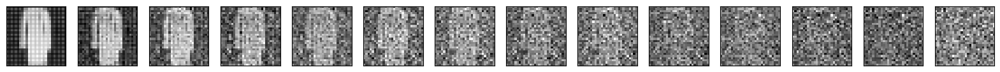

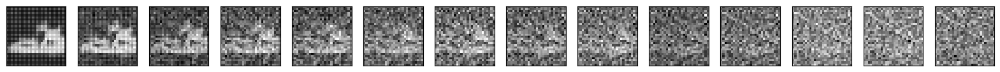

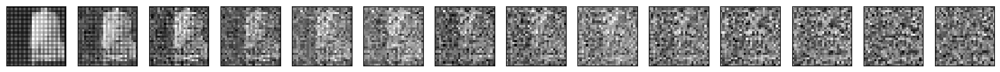

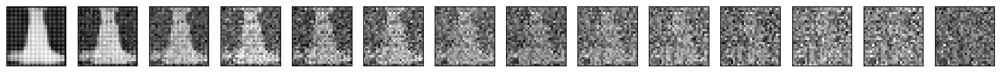

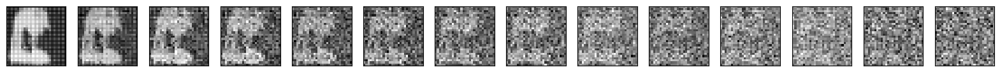

...

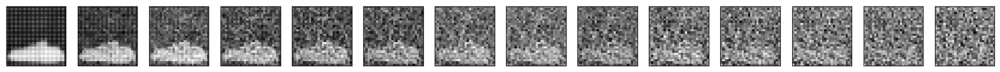

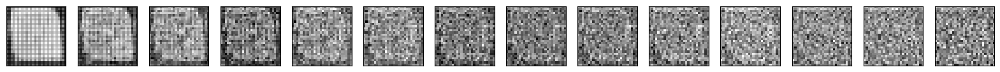

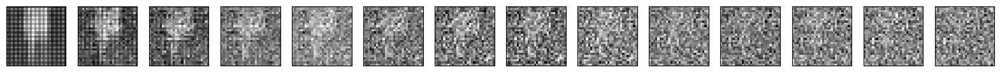

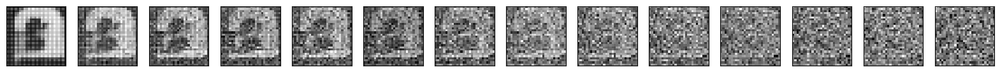

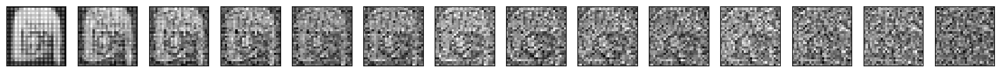

In [15]:

# Code for the plotting of samples goes here
num_samples = 25
shape =(num_samples,1,28,28)
seed = 350

samples = sample(model,shape,seed)

for img in range(num_samples):
    fig, axs = plt.subplots(nrows=1, ncols = 14)
    fig.set_figwidth(20)

    for i, idx in enumerate(range(0, T, stepsize)):
        a = samples[idx][img]
        axs[13-i].imshow(a.squeeze(), cmap="gray")
        axs[13-i].get_xaxis().set_visible(False)
        axs[13-i].get_yaxis().set_visible(False)
    plt.show()

Include your best generated samples below. 

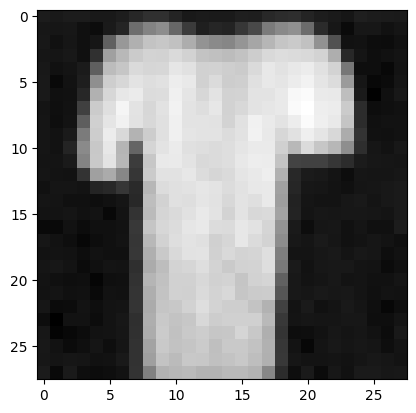

In [196]:
# Code to show the best samples goes here
a = samples[299][0]
a = Resize((28,28))(a).squeeze()
plt.imshow(a,cmap = "gray")

Include your most efficient implementation details below. 

In [16]:
# Code to make your most efficient setup goes here; present all code from above in one Code block
# run it to show final runtimes and print out the total number of parameters in the mode. 

class DoubleConv(nn.Module):
    def __init__(self, in_channels,out_channels,time_emb_dim):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU())
        self.conv2 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, 3, 1, 1),
            nn.GroupNorm(8,out_channels),
            nn.ReLU()
        )
        self.relu = nn.ReLU()
        self.time_mlp =  nn.Linear(time_emb_dim, out_channels)
    def forward(self,x,t):
        t = self.relu(self.time_mlp(t))
        x = self.conv1(x)
        x = x+ t[...,None][...,None]
        return self.conv2(x)
    
class UNET(nn.Module):
    def __init__(self,in_channels = 1, out_channels = 1):
        super().__init__()
        down_channels = (64,128) 
        up_channels = (128,64)

        time_emb_dim = 32
        #define Relu for later
        self.relu = nn.ReLU()
        # Time embedding consists of a Sinusoidal embedding, a linear map that maintains the dimensions and a rectified linear unit activation. 
        self.time_embedding = SinusoidalPositionEmbeddings(time_emb_dim)
        self.time_lin = nn.Linear(time_emb_dim,time_emb_dim)
        
        self.downs = nn.ModuleList()
        self.ups = nn.ModuleList()
        self.pool = nn.MaxPool2d(2,2)
        #downs
        for ch in down_channels:
            self.downs.append(DoubleConv(in_channels, ch,time_emb_dim))
            in_channels = ch
        
        #ups
        for ch in up_channels:
            self.ups.append(nn.ConvTranspose2d(2*ch,ch,2,2))
            self.ups.append(DoubleConv(2*ch,ch,time_emb_dim))

        self.bottleneck = DoubleConv(down_channels[-1], down_channels[-1]*2,time_emb_dim)
        self.final_conv = nn.Conv2d(up_channels[-1], out_channels,1, 1)

    def forward(self,x,timestep):
        t = self.relu(self.time_lin(self.time_embedding(timestep)))
        skips = []
        for down in self.downs:
            x = down(x,t)
            skips.append(x)
            x = self.pool(x)
        x = self.bottleneck(x,t)
        skips = skips[::-1]
        for idx in range(0,len(self.ups), 2):
            x = self.ups[idx](x)
            skip = skips[idx//2]
            concat_skip = torch.cat((skip,x),dim = 1)
            x = self.ups[idx+1](concat_skip,t)

        return self.final_conv(x)


In [63]:
# Code for the training loop goes here
from torch.optim import Adam

#define model
model = UNET()
print("Num params: ", sum(p.numel() for p in model.parameters()))

#sort out GPU
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

#optimizer
optimizer = Adam(model.parameters(), lr=1e-3)
epochs = 30


for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      batch["pixel_values"] = batch["pixel_values"].to(device)
      optimizer.zero_grad()
      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch["pixel_values"], t)
      loss.backward()
      optimizer.step()

      if epoch % 1 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")


Num params:  1886433
Epoch 0 | step 000 Loss: 1.295056939125061 
Epoch 1 | step 000 Loss: 0.0851069912314415 
Epoch 2 | step 000 Loss: 0.09154701977968216 
Epoch 3 | step 000 Loss: 0.07412299513816833 
Epoch 4 | step 000 Loss: 0.06774484366178513 
Epoch 5 | step 000 Loss: 0.08619004487991333 
Epoch 6 | step 000 Loss: 0.08504346758127213 
Epoch 7 | step 000 Loss: 0.06601957976818085 
Epoch 8 | step 000 Loss: 0.06749244034290314 
Epoch 9 | step 000 Loss: 0.05511309206485748 
Epoch 10 | step 000 Loss: 0.08175240457057953 
Epoch 11 | step 000 Loss: 0.06057124212384224 
Epoch 12 | step 000 Loss: 0.07845760136842728 
Epoch 13 | step 000 Loss: 0.0740983858704567 
Epoch 14 | step 000 Loss: 0.0643671527504921 
Epoch 15 | step 000 Loss: 0.061072252690792084 
Epoch 16 | step 000 Loss: 0.07785562425851822 
Epoch 17 | step 000 Loss: 0.06856228411197662 
Epoch 18 | step 000 Loss: 0.05812560021877289 
Epoch 19 | step 000 Loss: 0.08692961186170578 
Epoch 20 | step 000 Loss: 0.06920754909515381 
Epoch 

sampling loop time step: 100%|██████████| 300/300 [00:01<00:00, 217.76it/s]


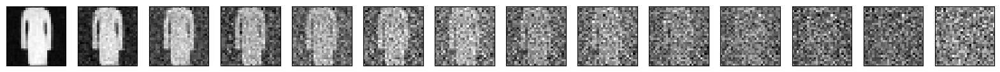

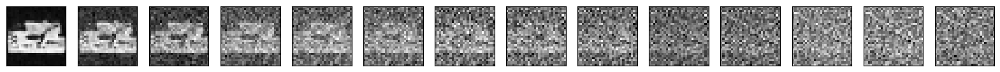

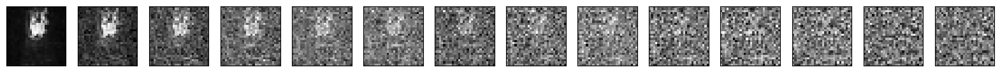

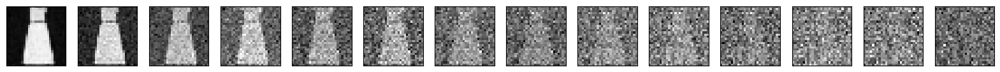

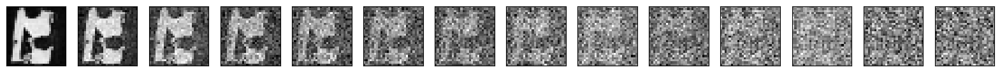

...

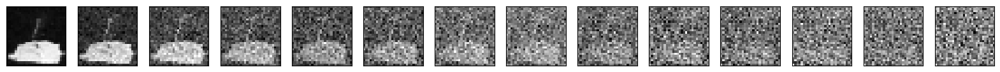

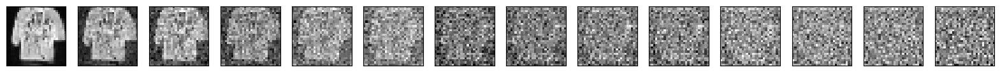

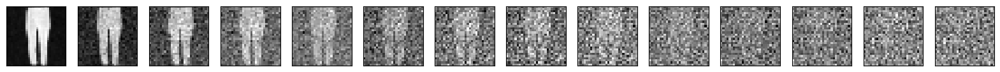

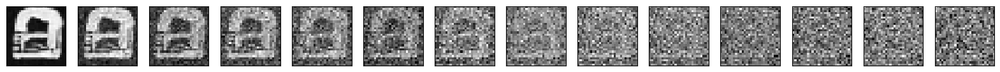

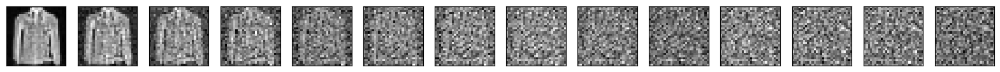

In [64]:

# Code for the plotting of samples goes here
num_samples = 25
shape =(num_samples,1,28,28)
seed = 350

samples = sample(model,shape,seed)

for img in range(num_samples):
    fig, axs = plt.subplots(nrows=1, ncols = 14)
    fig.set_figwidth(20)

    for i, idx in enumerate(range(0, T, stepsize)):
        a = samples[idx][img]
        axs[13-i].imshow(a.squeeze(), cmap="gray")
        axs[13-i].get_xaxis().set_visible(False)
        axs[13-i].get_yaxis().set_visible(False)
    plt.show()

In [164]:
a = torch.rand([1,1,28,28])
t = torch.tensor([30])
mod = UNET()
mod(a,t).shape

torch.Size([1, 1, 28, 28])

In [29]:
print("Num params: ", sum(p.numel() for p in mod.parameters()))

Num params:  890209


Interpretation of your results goes here. 

In [ ]:
# Here goes the code for visualising during training and add a discussion above. 

### Part 3. On DeepDream [5 points]

In this task we will implement a DeepDream model in order to generate ‘dreams’: images enhanced by the neural network. 

Here we will work with a pre-trained model (Inception-V3). The idea is as follows: we will load some image (you can later on choose to load your own image if you want). We will load the Inception-V3 model. We will pass it an input and obtain the activation outputs from a certain layer. We will 'ask' the neural network to maximise the values of the activation, i.e. enhance the image with what those layer activations 'like' to see. For this we will implement a gradient ascent method in order to maximise a norm of the activations over that input. This will change our input into a `dream'. 

1. [1 point] Write a piece of code that will load the Inception-V3 model and allow you to get access to the intermediate activations. 

2. [2 points] Implement the deepdream optimisation loop. We will use gradient ascent to optimise for the norm of the activation. Implement a function that performs this gradient ascent. This function will take as input the number of iterations to perform, the learning rate, and the start image (i.e. the image which the model will enhance). Define in the function a for loop over the number of iterations, obtain the model output, get the output of the hook (hint: use something like `outputs[-1]`), compute the loss which will be L2 norm of this output (i.e. the L2 norm of the activations from your chosen layer), compute the gradients of this L2 norm loss, scale the gradients by their absolute average (hint: scale using `torch.abs(g).mean()`) and define a gradient ascent step over the image. Do not forget to zero out gradients where needed. 

3. [1 point] Implement code to load an image (e.g. https://github.com/pytorch/hub/raw/master/images/dog.jpg) and display the output from your optimisation loop (using e.g. numpy). Present the generated images for different choices of layer activations and different number of optimisation steps. Discuss your results. What is the impact of using different layers? What is the impact of the number of optimisation steps? [0.5 point will be given for the implementation and 1.5 point for a very good discussion]

4. [1 point] In our previous setting we allowed for optimising for a single layer's activation. Change the method such that it will allow to compute the loss (L2 norm) of multiple layers' outputs. Present three different setups using different numbers & combinations of layers and discuss your results in max. 3 lines. 

In [2]:
# YOUR ANSWERS GO HERE
device = "cuda"
### 1 - load model ###
#put it in evaluation mode
model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True).eval().to(device)


Using cache found in C:\Users\frase/.cache\torch\hub\pytorch_vision_v0.10.0
d:\University-local\Imperial\Term 2\Mathematical Foundations of Machine Learning\venv\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\University-local\Imperial\Term 2\Mathematical Foundations of Machine Learning\venv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


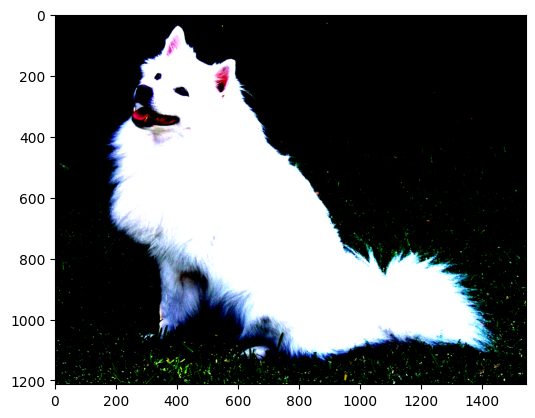

In [3]:
### Preprocess Image, as specified by torch pretrained models ###
#convert to [0,1] then normalize
img = read_image("dog.jpg")
#scale down
img = img.to(torch.float)/ 255.
#model syntax specifies they need to be normalised as so:
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

img = normalize(img)
#permute to display the image
plt.imshow(torch.permute(img,(1,2,0)))

#send to GPU
device = "cuda"
img = img.to(device)

In [4]:
#look at layers
layers = list(map(lambda x: x[0], model.named_children()))
print(layers)


#function that gets a certain layer
def get_activation(layer):
    def hook(model, input, output):
        layer.output = output
    return hook

#choose a layer
layer_name = 'fc'
layer = getattr(model, layer_name)
hook = layer.register_forward_hook(get_activation(layer))

['Conv2d_1a_3x3', 'Conv2d_2a_3x3', 'Conv2d_2b_3x3', 'maxpool1', 'Conv2d_3b_1x1', 'Conv2d_4a_3x3', 'maxpool2', 'Mixed_5b', 'Mixed_5c', 'Mixed_5d', 'Mixed_6a', 'Mixed_6b', 'Mixed_6c', 'Mixed_6d', 'Mixed_6e', 'AuxLogits', 'Mixed_7a', 'Mixed_7b', 'Mixed_7c', 'avgpool', 'dropout', 'fc']


In [5]:
### 2 ###

#loop
def deepdream_optimisation(n_iter, lr, img, verbose = True):
    #give img batch dimension
    img = img[None,...]
    #tell it to have gradients
    img.requires_grad = True
    #loop
    for i in range(n_iter):
        #zero gradients
        model.zero_grad()
        #output of model
        out = model(img)
        #the loss is the l2 norm of the activation:
        loss = torch.norm(layer.output, 2)
        loss.backward()
        #ascend gradient
        with torch.no_grad():
            grad = img.grad
            # Scale gradient by its absolute average
            img += lr * grad / torch.abs(grad).mean()
            #zero image gradient
            img.grad.zero_()
        if verbose:
            if i%100==0:
                print(loss.item(),i)

    # Convert the modified image back to PIL format for visualization
    img = img.detach().squeeze(0)
    #img = torch.clamp(img, 0, 1)
    return img


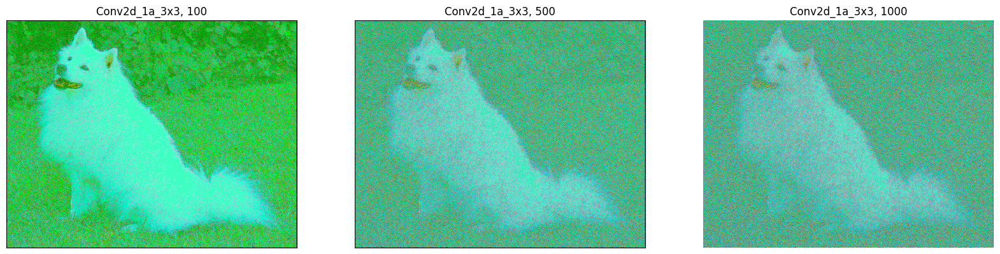

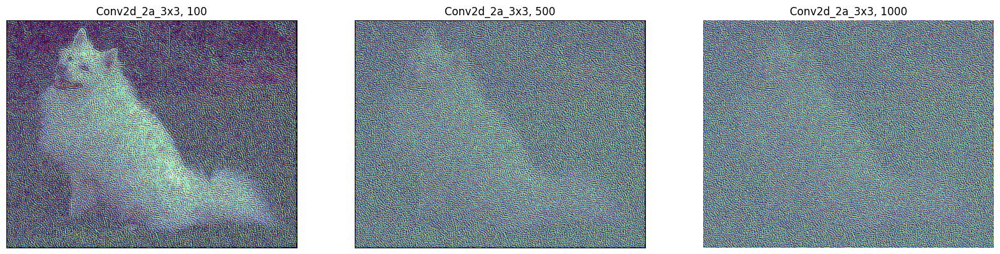

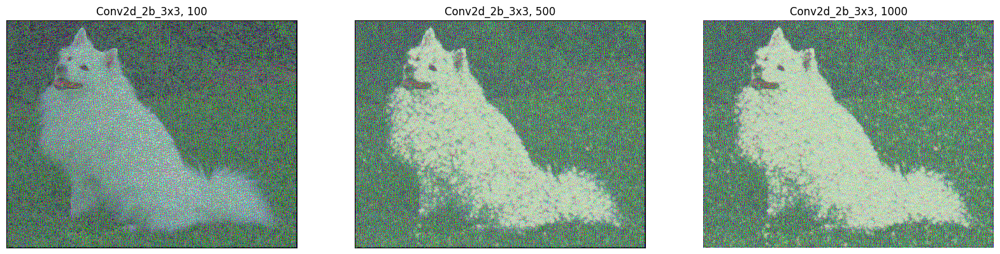

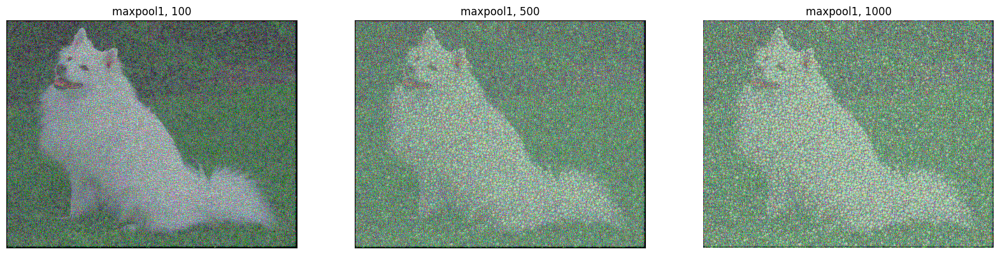

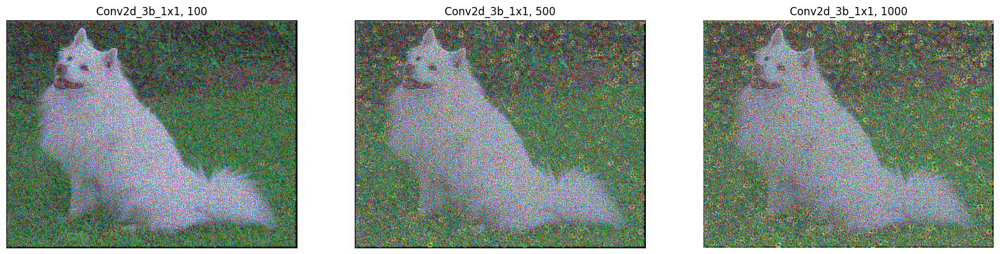

...

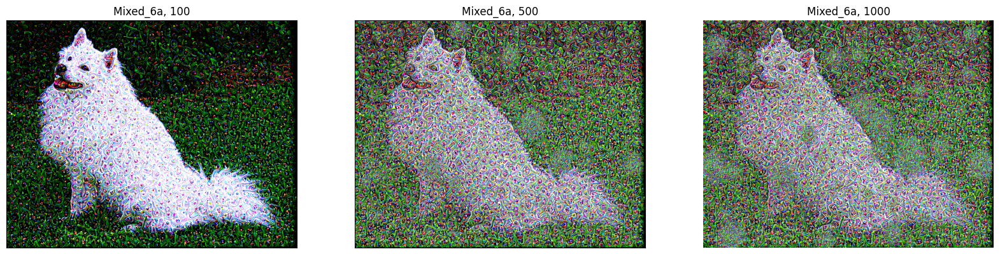

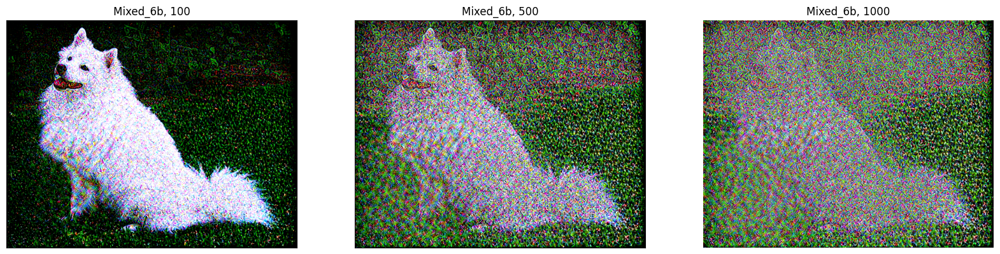

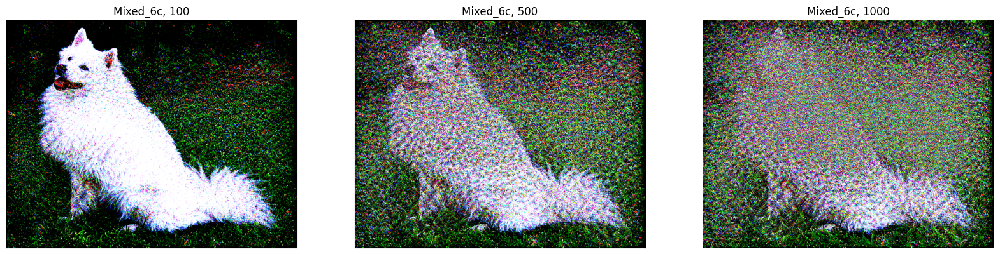

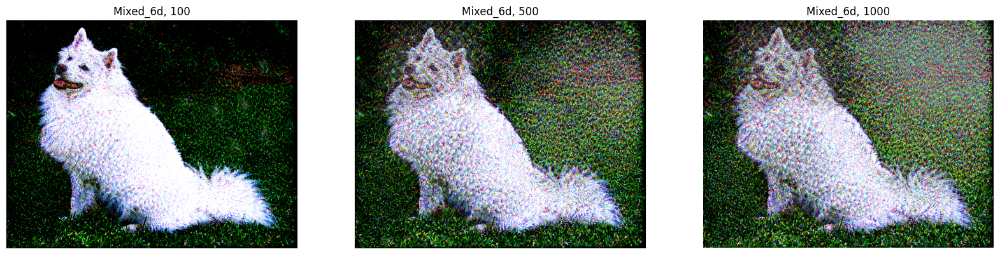

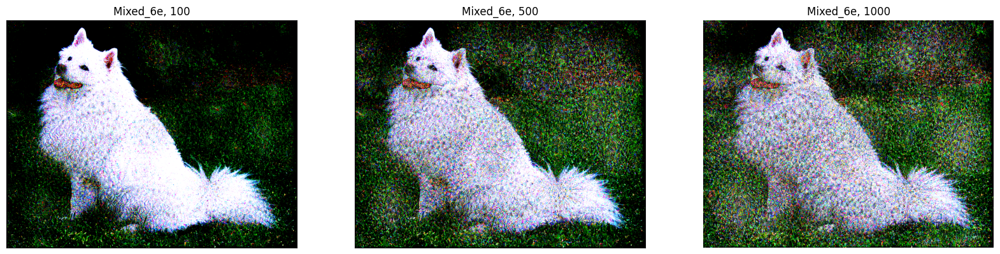

In [6]:
### 3 ###
#the iterations we will consider
n_iter = [100,500,1000]
device = "cuda"


#layers was defined earlier, the list of layer names
print(layers)

#we we do the first 15 layer, skip the 16 since it cannot be done, then the remaining layers
for layer_name in layers[:15]:
    #for each layer we will do three iteration numbers
    fig, axs = plt.subplots(nrows = 1,ncols = 3)
    plt.axis("off")
    fig.set_figheight(20)
    fig.set_figwidth(20)

    for j, n in enumerate(n_iter):
        #reset image:
        img = read_image("dog.jpg")
        img = img.to(torch.float)/ 255.
        normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                        std=[0.229, 0.224, 0.225])
        img = normalize(img).to(device)
        #set layer:
        layer = getattr(model, layer_name)
        hook = layer.register_forward_hook(get_activation(layer))   
        #sample    
        sample_image = deepdream_optimisation(n,0.05,img,verbose = False)
        #plot the image
        axs[j].imshow(torch.permute(torch.clamp(sample_image,0,1).cpu(),(1,2,0)))
        axs[j].set_title(f"{layer_name}, {n}")
        axs[j].get_xaxis().set_visible(False)
        axs[j].get_yaxis().set_visible(False)
    
    plt.show()

We see varied results in the first 15 layers, 

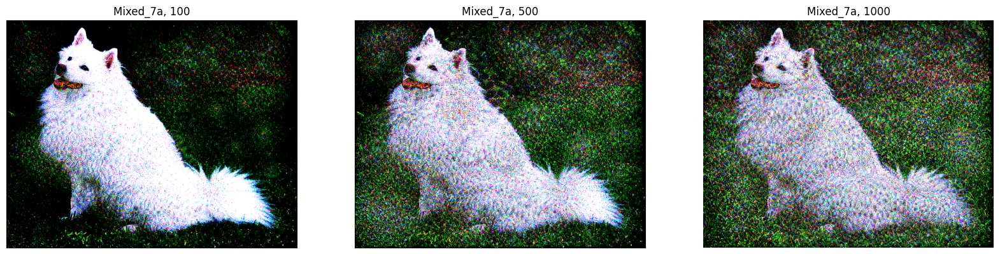

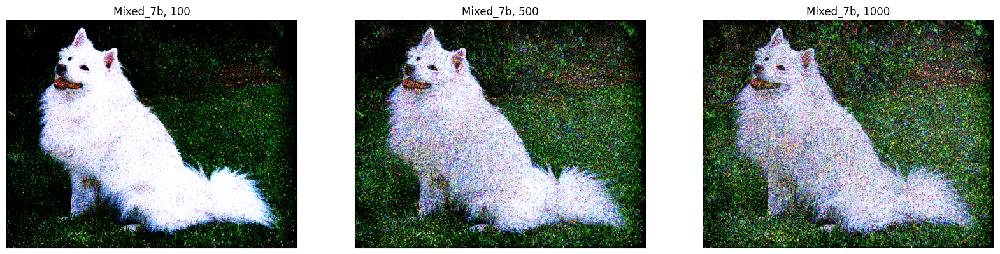

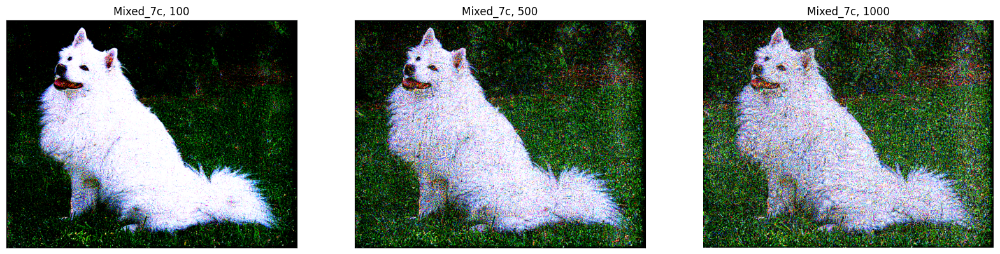

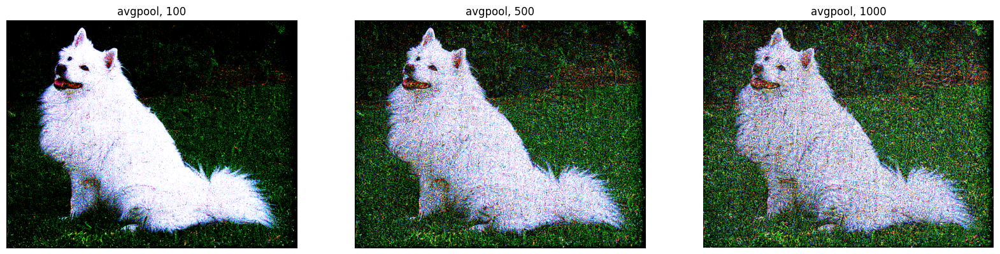

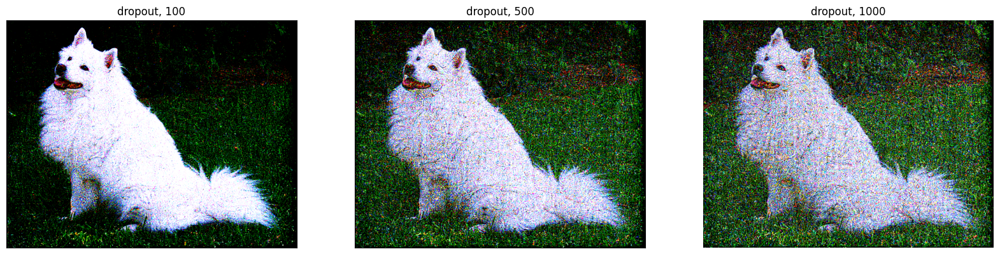

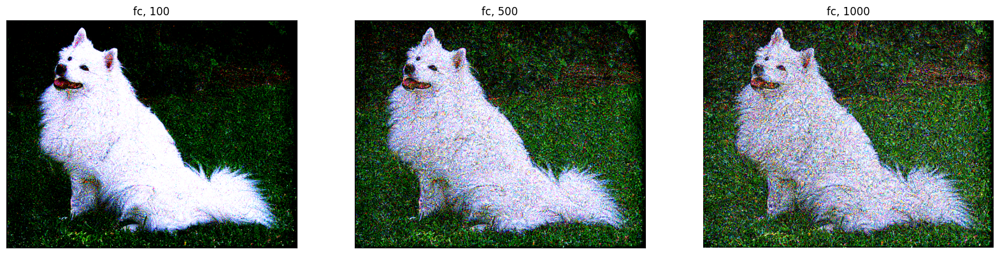

In [12]:
n_iter = [100,500,1000]
device = "cuda"


#the remaining layers
for layer_name in layers[16:]:
    fig, axs = plt.subplots(nrows = 1,ncols = 3)
    plt.axis("off")
    fig.set_figheight(20)
    fig.set_figwidth(20)

    for j, n in enumerate(n_iter):
        #reset image:
        img = read_image("dog.jpg")
        img = img.to(torch.float)/ 255.
        normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                        std=[0.229, 0.224, 0.225])
        img = normalize(img).to(device)
        #set layer:
        layer = getattr(model, layer_name)
        hook = layer.register_forward_hook(get_activation(layer))   
        #sample    
        sample_image = deepdream_optimisation(n,0.05,img,verbose = False)
        axs[j].imshow(torch.permute(torch.clamp(sample_image,0,1).cpu(),(1,2,0)))
        axs[j].set_title(f"{layer_name}, {n}")
        axs[j].get_xaxis().set_visible(False)
        axs[j].get_yaxis().set_visible(False)
    
    plt.show()